# <font color='lightblue'>Final project - sentiment analysis comparison part 1</font>

#Imports & functions

In [ ]:
!pip install pyspellchecker #spelling mistakescounter

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 10.8 MB/s eta 0:00:00


In [ ]:
!pip install bertopic #bert topic for vis

In [ ]:
import pandas as pd
import numpy as np
import math
import string
#connect to drive
from google.colab import drive
# visualisation
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from wordcloud import WordCloud

In [ ]:
#string to list
import ast
#tokanization, pos
import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
#stop words
from nltk.corpus import stopwords
nltk.download('stopwords')
#removal stop words
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
#NER name entity
import spacy
import spacy.cli
spacy.cli.download("en_core_web_sm")
#bert topics
#from bertopic import BERTopic
#from sklearn.datasets import fetch_20newsgroups
#remove punct
import re
#count of spelling mistakes
from spellchecker import SpellChecker
#common words
from collections import defaultdict
# lemmatization
from nltk.stem import WordNetLemmatizer
nltk.download('averaged_perceptron_tagger')
from nltk.corpus import wordnet
nltk.download('wordnet')
#split train and test
from sklearn.model_selection import train_test_split
# for scailng and standartization
from sklearn.preprocessing import MinMaxScaler
from sklearn import preprocessing

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /root/nltk_data...


In [ ]:
def make_wordcloud(words,title):
    cloud = WordCloud(width=1920, height=1080,max_font_size=200, max_words=350, background_color="white").generate(words)
    plt.figure(figsize=(20,20))
    plt.imshow(cloud, interpolation="gaussian")
    plt.axis("off")
    plt.title(title, fontsize=60)
    plt.show()

In [ ]:
#given text tokens and a list - count number of tokens that are in the list
def count_words_from_list(text_tokens,list_of_words):
  count=0
  for w in text_tokens:
    if w in list_of_words:
      count=count+1
  return count

In [ ]:
#get list of the words (ner label) that are name entities
def spacy_large_ner_label(document):
  return [( ent.label_) for ent in sp_sm(document).ents]

In [ ]:
#get list of the words (text) that are name entities
def spacy_large_ner_text(document):
  return [(ent.text.strip()) for ent in sp_sm(document).ents]

In [ ]:
# aggregate values of categorial feature with high cardenality (any vlaue that appears less than a spesific percent is becoming "other")
def aggregate_other_group_for_high_cardenality_handeling (df,cat_coulmn_name,grouped_col_name,over_percent=0.01):
  new_df=df.copy()
  new_df['percent']=new_df.groupby(cat_coulmn_name)[cat_coulmn_name].transform('size')/new_df.shape[0]
  new_df[grouped_col_name]=new_df[cat_coulmn_name]
  new_df[grouped_col_name].loc[new_df['percent']<over_percent]='other'
  return new_df

In [ ]:
def count_spelling_mistakes(sentance):
  spell = SpellChecker()
  misspelled=spell.unknown(sentance.split())
  return len(misspelled)

In [ ]:
def get_top_n_words_from_string(long_str,top_n): # return df as result
  split_data=long_str.split()
  dict_of_words = defaultdict(int)
  for word in split_data:
    dict_of_words[word] += 1
  dct = defaultdict(list)
  for k, v in dict_of_words.items():
    dct[v].append(k)
  top_words_dict= sorted(dct.items())[-top_n:][::-1]
  top_words=pd.DataFrame.from_dict(top_words_dict)
  top_words=top_words.rename(columns={0: "count", 1: "word"})
  top_words['word']=top_words['word'].apply(lambda x:x[0])
  return top_words

In [ ]:
def remove_html_tags(text):
    pattern = re.compile('<.*?>')
    return pattern.sub(r'',text)

In [ ]:
def remove_urls(text):
    pattern = re.compile(r'https?:\/\/.*?[\s+]')
    return pattern.sub(r'',text)

In [ ]:
def count_punc(sentence):
  punc_list = string.punctuation
  counter=0
  for i in punc_list:
    counter=counter+sentence.count(i)
  return counter

In [ ]:
# Visualisation of numeric features
def vis_label_numeric_features(df,label_col_name,numeric_col_list):
  for col in numeric_col_list:

    #calc rice critirion for deciding nbins
    n=df[col].value_counts().count()
    k=round((math.pow(n, (1/3)))*3) # multiplying on 3 and not 2 as usual
    print("\n feature name: ",col)
    fig3 = px.histogram(df, x=col, nbins=k,title='Distrabution of '+col,color_discrete_sequence=px.colors.qualitative.Pastel)
    fig3.show()

    fig4 = px.box(df, x=label_col_name, y=col, color=label_col_name,color_discrete_sequence=[px.colors.qualitative.Pastel[4],px.colors.qualitative.Pastel[2]],title="Box plot of "+col)
    fig4.update_traces(quartilemethod="exclusive") # or "inclusive", or "linear" by default
    fig4.show()

In [ ]:
# for each words that's not on the list, lower and remove punctuations
def lower_and_remove_punct_excpet_listed(sentence,list_words_not_to_lower):
  words=sentence.split()
  new_str_lst=[]
  for w in words:
    if w not in list_words_not_to_lower:
      lowered = w.lower()
      clean = re.sub(r'[^\w\s]', '', lowered)
      new_str_lst.append(clean)
    else:
      new_str_lst.append(w)
  new_str=" ".join(new_str_lst)
  return(new_str)

In [ ]:
def remove_stop_words(tokenized_sen,stop_word_set):
  filtered_sentence = [w for w in tokenized_sen if not w.lower() in stop_word_set]
  filtered_sentence = []
  for w in tokenized_sen:
    if w not in stop_words:
        filtered_sentence.append(w)
  return filtered_sentence

In [ ]:
def pos_tagger(nltk_tag):
    if nltk_tag.startswith('J'):
        return wordnet.ADJ
    elif nltk_tag.startswith('V'):
        return wordnet.VERB
    elif nltk_tag.startswith('N'):
        return wordnet.NOUN
    elif nltk_tag.startswith('R'):
        return wordnet.ADV
    else:
        return None

In [ ]:
def organize_pos_tags(pos_tagged):
  return list(map(lambda x: (x[0], pos_tagger(x[1])), pos_tagged))

In [ ]:
def lemmatize_with_pos(wordnet_tagged):
  lemmatized_sentence = []
  for word, tag in wordnet_tagged:
      if tag is None:
          # if there is no available tag, append the token as is
          lemmatized_sentence.append(word)
      else:
          # else use the tag to lemmatize the token
          lemmatized_sentence.append(lemmatizer.lemmatize(word, tag))
  lemmatized_sentence = " ".join(lemmatized_sentence)
  return lemmatized_sentence

In [ ]:
# standartization - (X-mu)/var in order to make numeric field in normal distrabution with mu =0 and var =1
def data_standartization_scaling(df,cat_col_list,num_col_list):
  num_train=df[num_col_list]
  scaler = preprocessing.StandardScaler().fit(num_train)
  num_train_standartized = scaler.transform(num_train)
  # scaling - make all the numeric features between 0-1
  scaler = MinMaxScaler()
  scaler.fit(num_train_standartized)
  scaled = scaler.transform(num_train_standartized)
  df_num_scaled = pd.DataFrame(scaled, columns=num_col_list)
  new_list_cat_col=cat_col_list.copy()
  # new_list_cat_col.append("id")
  new_list_cat_col.append("label")
  df_cat=df[new_list_cat_col]
  scaled_stand_df = pd.concat([df_num_scaled.reset_index(drop=True), df_cat.reset_index(drop=True)], axis=1, sort=False)
  return scaled_stand_df

# Load data

In [ ]:
# data is from : https://www.kaggle.com/datasets/therohk/ireland-historical-news?datasetId=30661
drive.mount('/content/drive')
path = "/content/drive/MyDrive/final project/data_files/IMDB Dataset.csv"
df = pd.read_csv(path)
df=df.rename(columns={'sentiment':'label'})
print("Shape: ",df.shape)
print(df.isna().sum())
df.head()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Shape:  (50000, 2)
review    0
label     0
dtype: int64


,review,label
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive


In [ ]:
fig = px.pie(df, names='label',color_discrete_sequence=[px.colors.qualitative.Pastel[4],px.colors.qualitative.Pastel[2]],title='Label distrabution',width=600,height=600) # Setting Heart_ stroke as the label
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

# Data exploration

## Most common words - word cloud

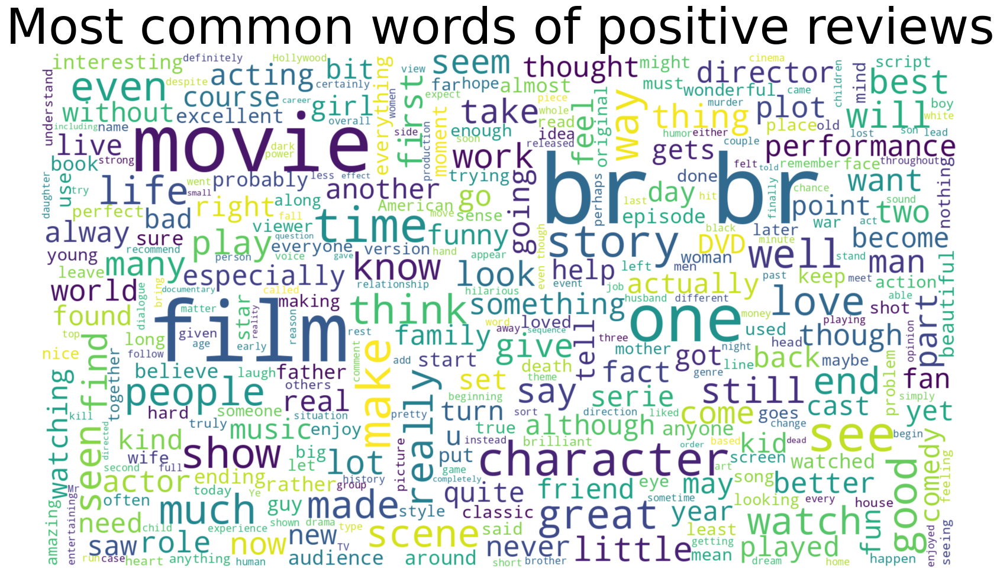

In [ ]:
all_text_positive = " ".join(df[df.label == "positive"].review)
make_wordcloud(all_text_positive, "Most common words of positive reviews")

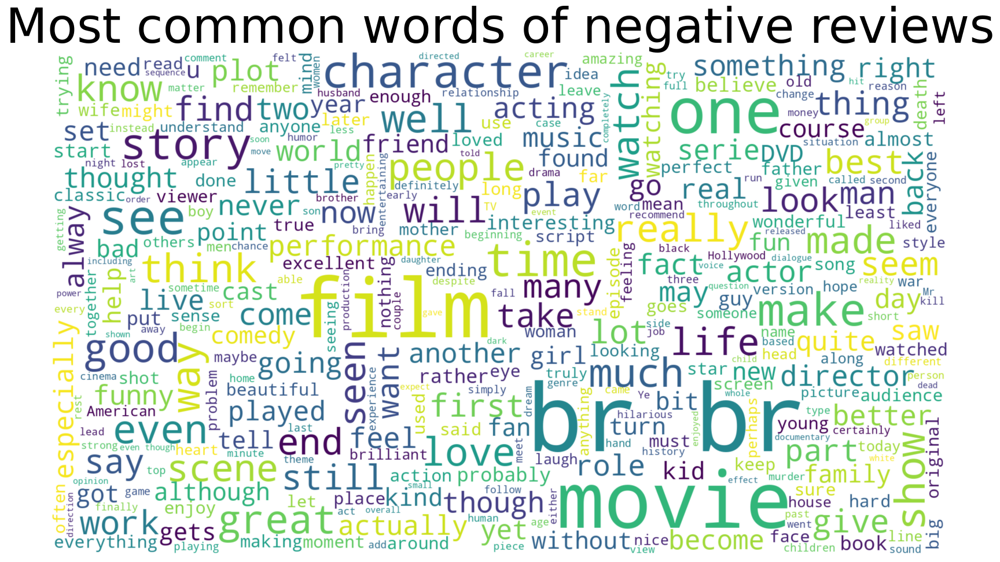

In [ ]:
all_text_negative = " ".join(df[df.label != "negative"].review)
make_wordcloud(all_text_positive, "Most common words of negative reviews")

In [ ]:
# Some conclusions:
# remove <br /><br /> and other html tags

## visualisation of stop words



In [ ]:
df["review"] = df["review"].apply(lambda x: str(x))
df['tokenized'] = df['review'].str.lower().apply(nltk.word_tokenize)

In [ ]:
stopwords = nltk.corpus.stopwords.words('english')
df['stop_words_count'] = df.tokenized.apply(lambda x: count_words_from_list(x,stopwords))
#df['count_of_words']=df.tokenized.apply(lambda x: len(x)) better after removal of html tags and urls

In [ ]:
grouped_sw=df[['text_label','stop_words_count','count_of_words']].groupby(by=["text_label"], dropna=False).sum().reset_index()
grouped_sw['percent_of_stop_words']=grouped_sw['stop_words_count']/grouped_sw['count_of_words']

fig = px.bar(grouped_sw.sort_values(by=['percent_of_stop_words']), x="text_label", y="percent_of_stop_words", color='text_label',hover_data=['stop_words_count','count_of_words'],text="percent_of_stop_words",
             color_discrete_sequence=[px.colors.qualitative.Pastel[4],px.colors.qualitative.Pastel[2]],title='Percent of stop words per label')
fig.update_traces(texttemplate='%{text:.3}%')
fig.show()

## Unsupervised topics

In [ ]:
model = BERTopic()
text=df['review'].tolist()
topics, probs = model.fit_transform(text)

In [ ]:
model.get_topic_info()

,Topic,Count,Name
0,-1,21147,-1_this_it_the_to
1,0,1858,0_bad_worst_movie_acting
2,1,1011,1_false___
3,2,647,2_bollywood_indian_india_khan
4,3,536,3_sex_porn_women_sexual
...,...,...,...
777,776,10,776_cartoon_cartoons_inki_blackface
778,777,10,777_ritter_bridget_kerry_cj
779,778,10,778_quoteworthy_tambourineunbeatable_flynch_bu...
780,779,10,779_frye_vampire_brettschneider_bat


In [ ]:
# Visualize top topic keywords
model.visualize_barchart(top_n_topics=12)

In [ ]:
# Visualize connections between topics using hierachical clustering
model.visualize_hierarchy(top_n_topics=10)

## NER - name entity recognition visualisation

In [ ]:
list_of_name_entites=['ORG', 'CARDINAL', 'DATE', 'GPE', 'PERSON', 'MONEY', 'PRODUCT', 'TIME', 'PERCENT', 'WORK_OF_ART', 'QUANTITY', 'NORP', 'LOC', 'EVENT', 'ORDINAL', 'FAC', 'LAW', 'LANGUAGE']

In [ ]:
sp_sm = spacy.load('en_core_web_sm') #takes over an hour and a half
# add ner entity label and text
df['ner']=df.review.apply(lambda x:spacy_large_ner_label(x))
df['ner_text']=df.review.apply(lambda x:spacy_large_ner_text(x))

In [ ]:
df['count_of_ners']=df.ner.apply(lambda x: len(x))
df['has_ner']='True'
df['has_ner'].loc[df['count_of_ners']==0]='False'


<ipython-input-24-a65a2c6334b6>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# pie chart distrabution of headlines with at least one name entity
fig = px.pie(df, names='has_ner',color_discrete_sequence=[px.colors.qualitative.Pastel[4],px.colors.qualitative.Pastel[2]],title='Percent of headlines with at least one name entity') # Setting Heart_ stroke as the label
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [ ]:
ne_exploded=df.explode('ner') #duplicate rows per each ner per row ( a row with ['ORG','PERSON'] would split into 2 rows)
clean_ne_eploded=ne_exploded.loc[ne_exploded['label']!='False']
grouped_ne=clean_ne_eploded[['label','ner','count_of_ners']].groupby(by=["label","ner"], dropna=False).count().reset_index()
grouped_ne['Percentage']=100 * grouped_ne['count_of_ners'] / grouped_ne.groupby('label')['count_of_ners'].transform('sum')
grouped_ne.head()

,label,ner,count_of_ners,Percentage
0,negative,CARDINAL,34291,12.864560
1,negative,DATE,20054,7.523429
2,negative,EVENT,1192,0.447189
3,negative,FAC,1900,0.712801
4,negative,GPE,19870,7.454399


In [ ]:
fig = px.bar(grouped_ne, x="label", y="Percentage",color='ner',text='Percentage',color_discrete_sequence=px.colors.qualitative.Pastel,title='Percent of ner per label and ner type')
fig.update_traces(texttemplate='%{text:.4}%')
fig.show()

## counter features

In [ ]:
df['review'] = df['review'].apply(remove_html_tags) # remove html tags <br /><br /> before words counter, punc counter
df['review'] = df['review'].apply(remove_urls) # remove urls before words counter, punc counter
df['tokenized'] = df['review'].str.lower().apply(nltk.word_tokenize)
df['pos_tag'] = df['tokenized'].apply(nltk.pos_tag)
df['nouns'] = df['pos_tag'].apply(lambda x: [word for word, tag in x if tag in ['NN', 'NNS', 'NNP', 'NNPS']])
df['verbs'] = df['pos_tag'].apply(lambda x: [word for word, tag in x if tag in ['VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ']])
df['adjective'] = df['pos_tag'].apply(lambda x: [word for word, tag in x if tag in ['JJ', 'JJR', 'JJS']])
df['nouns_count']=df['nouns'].apply(lambda x: len(x))
df['verbs_count']=df['verbs'].apply(lambda x: len(x))
df['adjective_count']=df['adjective'].apply(lambda x: len(x))
df['count_misspelling']=df['review'].apply(lambda x: count_spelling_mistakes(x)) #takes an hour


In [ ]:
df['count_upper_case']=df['review'].apply(lambda x:sum(1 for c in x if c.isupper()))
df['count_punc'] = df['review'].apply(lambda x:count_punc(x))
df['count_of_words'] = df['review'].apply(lambda x:len(x.split()))


In [ ]:
df['percent_of_ner']=       pd.to_numeric(df['count_of_ners']   )/df['count_of_words']
df['percent_of_punc']=      pd.to_numeric(df['count_punc']      )/df['count_of_words']
df['percent_of_upper_case']=pd.to_numeric(df['count_upper_case'])/df['count_of_words']
df['percent_of_nouns']=     pd.to_numeric(df['nouns_count']     )/df['count_of_words']
df['percent_of_verbs']=     pd.to_numeric(df['verbs_count']     )/df['count_of_words']
df['percent_of_adj']=       pd.to_numeric(df['adjective_count'] )/df['count_of_words']
df['percent_of_stop_words']=pd.to_numeric(df['stop_words_count'])/df['count_of_words']
df['percent_of_misspelling']=pd.to_numeric(df['count_misspelling'])/df['count_of_words']

In [ ]:
lits_numeric_features=['count_of_words','percent_of_ner','percent_of_misspelling','percent_of_punc','percent_of_upper_case','percent_of_stop_words','percent_of_nouns','percent_of_verbs','percent_of_adj']

In [ ]:
vis_label_numeric_features(df,'label',lits_numeric_features)


 feature name:  count_of_words



 feature name:  percent_of_ner



 feature name:  percent_of_misspelling



 feature name:  percent_of_punc



 feature name:  percent_of_upper_case



 feature name:  percent_of_stop_words



 feature name:  percent_of_nouns



 feature name:  percent_of_verbs



 feature name:  percent_of_adj


In [ ]:
df['text_label']=df['label']
df['label'] = df['label'].replace('positive', 1)
df['label'] = df['label'].replace('negative', 0)

In [ ]:
df_copy=df.copy()

In [ ]:
list_cat_cols=['review','ner_text']

In [ ]:
df=data_standartization_scaling(df,list_cat_cols,lits_numeric_features)

### corelation

In [ ]:
list_for_corr=lits_numeric_features.copy()
list_for_corr.append('label')
corr_matrix = df[list_for_corr].corr()
fig = px.imshow(corr_matrix, text_auto=True)
fig.show()

# Typical negative/positive keywords

## pre processing

### lower case & remove punctuations for all non-NERs

In [ ]:
df['review']=df.apply(lambda x: lower_and_remove_punct_excpet_listed(x['review'],x['ner_text']),axis=1)
df.head()

,count_of_words,percent_of_ner,percent_of_misspelling,percent_of_punc,percent_of_upper_case,percent_of_stop_words,percent_of_nouns,percent_of_verbs,percent_of_adj,review,ner_text,label
0,0.121423,0.125803,0.194906,0.073260,0.032884,0.669336,0.188404,0.460220,0.177187,One of the other reviewers has mentioned that ...,"[One, just 1 Oz, the Oswald Maximum Security S...",1
1,0.062142,0.141595,0.239316,0.061254,0.023609,0.654832,0.184835,0.443995,0.145299,a wonderful little production the filming tech...,"[BBC, Michael Sheen, Williams, about one, Orto...",1
2,0.064595,0.175309,0.181070,0.063522,0.032681,0.700644,0.170701,0.534438,0.164609,i thought this was a wonderful way to spend ti...,"[summer weekend, Match Point 2: Risk Addiction...",1
3,0.052330,0.119529,0.191919,0.066822,0.041852,0.709402,0.233339,0.468501,0.070707,basically theres a family where a little boy j...,"[Jake, Rambo, first, BOOGEYMAN, 10]",0
4,0.089125,0.213213,0.222222,0.052976,0.035254,0.639101,0.220360,0.401138,0.186186,petter matteis love in the time of money is a ...,"[Petter Mattei's, Love in the Time of Money, M...",1


### remove stop words

In [ ]:
df['tokenized'] = df['review'].apply(nltk.word_tokenize)

In [ ]:
nltk.download('stopwords')
print(stopwords.words('english'))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
stop_words = set(stopwords.words('english'))
df['clean_tokenized']=df['tokenized'].apply(lambda x: remove_stop_words(x,stop_words))
df.head()

,count_of_words,percent_of_ner,percent_of_misspelling,percent_of_punc,percent_of_upper_case,percent_of_stop_words,percent_of_nouns,percent_of_verbs,percent_of_adj,review,ner_text,label,tokenized,clean_tokenized
0,0.121423,0.125803,0.177187,0.073260,0.032884,0.655195,0.192558,0.452002,0.172757,One of the other reviewers has mentioned that ...,"['One', 'just 1 Oz', 'the Oswald Maximum Secur...",1,"[One, of, the, other, reviewers, has, mentione...","[One, reviewers, mentioned, watching, 1, Oz, e..."
1,0.062142,0.141595,0.213675,0.061254,0.023609,0.654832,0.159583,0.396424,0.119658,A wonderful little production. The filming tec...,"['BBC', 'Michael Sheen', 'Williams', 'about on...",1,"[A, wonderful, little, production, ., The, fil...","[A, wonderful, little, production, ., The, fil..."
2,0.064595,0.175309,0.164609,0.063522,0.032681,0.683128,0.153037,0.534438,0.164609,I thought this was a wonderful way to spend ti...,"['summer weekend', 'Match Point 2: Risk Addict...",1,"[I, thought, this, was, a, wonderful, way, to,...","[I, thought, wonderful, way, spend, time, hot,..."
3,0.052330,0.119529,0.151515,0.066822,0.041852,0.698653,0.158738,0.487241,0.080808,Basically there's a family where a little boy ...,"['Jake', 'Rambo', 'first', 'BOOGEYMAN', '10']",0,"[Basically, there, 's, a, family, where, a, li...","[Basically, 's, family, little, boy, (, Jake, ..."
4,0.089125,0.213213,0.192192,0.052976,0.035254,0.619928,0.201821,0.367710,0.162162,"Petter Mattei's ""Love in the Time of Money"" is...","[""Petter Mattei's"", 'Love in the Time of Money...",1,"[Petter, Mattei, 's, ``, Love, in, the, Time, ...","[Petter, Mattei, 's, ``, Love, Time, Money, ''..."


### lemmatization

In [ ]:
lemmatizer = WordNetLemmatizer()

In [ ]:
df['pos_tag'] = df['clean_tokenized'].apply(nltk.pos_tag)

In [ ]:
#lematize
df['wordnet_tagged']=df['pos_tag'].apply(lambda x: organize_pos_tags(x))
df['clean_lemmatized_headlines']=df['wordnet_tagged'].apply(lambda x : lemmatize_with_pos(x))

In [ ]:
df['final_tokenized'] = df['clean_lemmatized_headlines'].apply(nltk.word_tokenize)

In [ ]:
df.head()

,count_of_words,percent_of_ner,percent_of_misspelling,percent_of_punc,percent_of_upper_case,percent_of_stop_words,percent_of_nouns,percent_of_verbs,percent_of_adj,review,ner_text,label,tokenized,clean_tokenized,pos_tag,wordnet_tagged,clean_lemmatized_headlines,final_tokenized,clean_reviews
0,0.121423,0.125803,0.177187,0.073260,0.032884,0.655195,0.192558,0.452002,0.172757,One of the other reviewers has mentioned that ...,"['One', 'just 1 Oz', 'the Oswald Maximum Secur...",1,"[One, of, the, other, reviewers, has, mentione...","[One, reviewers, mentioned, watching, 1, Oz, e...","[(One, CD), (reviewers, NNS), (mentioned, VBD)...","[(One, None), (reviewers, n), (mentioned, v), ...",One reviewer mention watch 1 Oz episode 'll ho...,"[One, reviewer, mention, watch, 1, Oz, episode...",One reviewer mention watch 1 Oz episode 'll ho...
1,0.062142,0.141595,0.213675,0.061254,0.023609,0.654832,0.159583,0.396424,0.119658,A wonderful little production. The filming tec...,"['BBC', 'Michael Sheen', 'Williams', 'about on...",1,"[A, wonderful, little, production, ., The, fil...","[A, wonderful, little, production, ., The, fil...","[(A, DT), (wonderful, JJ), (little, JJ), (prod...","[(A, None), (wonderful, a), (little, a), (prod...",A wonderful little production . The filming te...,"[A, wonderful, little, production, ., The, fil...",A wonderful little production . The filming te...
2,0.064595,0.175309,0.164609,0.063522,0.032681,0.683128,0.153037,0.534438,0.164609,I thought this was a wonderful way to spend ti...,"['summer weekend', 'Match Point 2: Risk Addict...",1,"[I, thought, this, was, a, wonderful, way, to,...","[I, thought, wonderful, way, spend, time, hot,...","[(I, PRP), (thought, VBD), (wonderful, JJ), (w...","[(I, None), (thought, v), (wonderful, a), (way...",I think wonderful way spend time hot summer we...,"[I, think, wonderful, way, spend, time, hot, s...",I think wonderful way spend time hot summer we...
3,0.052330,0.119529,0.151515,0.066822,0.041852,0.698653,0.158738,0.487241,0.080808,Basically there's a family where a little boy ...,"['Jake', 'Rambo', 'first', 'BOOGEYMAN', '10']",0,"[Basically, there, 's, a, family, where, a, li...","[Basically, 's, family, little, boy, (, Jake, ...","[(Basically, NNP), ('s, POS), (family, NN), (l...","[(Basically, n), ('s, None), (family, n), (lit...",Basically 's family little boy ( Jake ) think ...,"[Basically, 's, family, little, boy, (, Jake, ...",Basically 's family little boy ( Jake ) think ...
4,0.089125,0.213213,0.192192,0.052976,0.035254,0.619928,0.201821,0.367710,0.162162,"Petter Mattei's ""Love in the Time of Money"" is...","[""Petter Mattei's"", 'Love in the Time of Money...",1,"[Petter, Mattei, 's, ``, Love, in, the, Time, ...","[Petter, Mattei, 's, ``, Love, Time, Money, ''...","[(Petter, NNP), (Mattei, NNP), ('s, POS), (``,...","[(Petter, n), (Mattei, n), ('s, None), (``, No...",Petter Mattei 's `` Love Time Money '' visuall...,"[Petter, Mattei, 's, ``, Love, Time, Money, ``...",Petter Mattei 's `` Love Time Money `` visuall...


In [ ]:
df['clean_reviews']=df['clean_lemmatized_headlines']

### split train-test

In [ ]:
y=df['label']
lst_for_models=['clean_reviews','final_tokenized','count_of_words','percent_of_ner','percent_of_misspelling','percent_of_punc','percent_of_upper_case','percent_of_stop_words','percent_of_nouns','percent_of_verbs','percent_of_adj']
X=df[lst_for_models]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
df_train=X_train
df_train['label']=y_train

In [ ]:
df_test=X_test
df_test['label']=y_test

### visualisation for top negative/positive words

In [ ]:
# drive.mount('/content/drive')
# path = "/content/drive/MyDrive/final project/data_files/train_ml.csv"
# df = pd.read_csv(path)
# df.drop(['Unnamed: 0'], axis='columns', inplace=True)
# df.head()

In [ ]:
negative_data_set=" ".join(X_train[df_train.label == 0].clean_reviews)
negative_top_df=get_top_n_words_from_string(negative_data_set,200)
positive_data_set=" ".join(X_train[df_train.label == 1].clean_reviews)
positive_top_df=get_top_n_words_from_string(positive_data_set,200)

In [ ]:
fig = make_subplots(rows=1, cols=2, shared_yaxes=True)

fig.add_trace(go.Bar(name="negative",x=negative_top_df['word'], y=negative_top_df['count'],
                    marker=dict(color=px.colors.qualitative.Pastel[2])),
              1, 1)

fig.add_trace(go.Bar(name="positive",x=positive_top_df['word'], y=positive_top_df['count'],
                    marker=dict(color=px.colors.qualitative.Pastel[4])),
              1, 2)

fig.update_layout(showlegend=True,title='Top 200 keywords for negative & positive label')
fig.show()


In [ ]:
raw_positive_lst=positive_top_df['word'].to_list()
raw_negative_lst=negative_top_df['word'].to_list()
#clean common words that are common for positive & negative
clean_positive_lst = list(set(raw_positive_lst) - set(raw_negative_lst))
clean_negative_lst = list(set(raw_negative_lst) - set(raw_positive_lst))
print("clean_positive_lst: ",clean_positive_lst,'\n clean_negative_lst: ',clean_negative_lst)

clean_positive_lst:  ['episode', 'kind', 'move', 'live', 'series', 'true', 'world', 'recommend', 'different', 'classic', 'enjoy', 'beautiful', 'last', 'wonderful', 'John', 'bring', 'course', 'They', 'job', 'moment', 'always', 'screen', 'DVD', 'music', 'excellent', 'child', 'She', 'yet', 'family', 'fun'] 
 clean_negative_lst:  ['hard', '2', 'So', 'someone', 'idea', 'money', 'What', 'mean', 'anything', 'attempt', 'stupid', 'That', 'let', 'nothing', 'least', 'awful', 'problem', 'suppose', 'terrible', 'anyone', 'sense', 'main', 'effect', 'shot', 'minute', 'call', 'reason', 'hour', 'script', 'waste']


In [ ]:
df_train['positve_words_counter']=df_train['final_tokenized'].apply(lambda x:count_words_from_list(x,clean_positive_lst))
df_train['negative_words_counter']=df_train['final_tokenized'].apply(lambda x:count_words_from_list(x,clean_negative_lst))
df_train['positve_words_counter']=df_train['positve_words_counter'].replace(0,0.1) #avoidind deviation by 0 while capturing the essance
df_train['negative_words_counter']=df_train['negative_words_counter'].replace(0,0.1) #avoidind deviation by 0 while capturing the essance

df_train['positve_negative_words_ratio']=df_train['positve_words_counter']/df_train['negative_words_counter'] # lower than 1 tend to be negative more than 1 tend to be positive
df_train.head()

,clean_reviews,final_tokenized,count_of_words,percent_of_ner,percent_of_misspelling,percent_of_punc,percent_of_upper_case,percent_of_stop_words,percent_of_nouns,percent_of_verbs,percent_of_adj,label,positve_words_counter,negative_words_counter,positve_negative_words_ratio
39087,"That 's I keep ask many fight , scream match ,...","[That, 's, I, keep, ask, many, fight, ,, screa...",0.159444,0.080090,0.196277,0.066228,0.024538,0.698599,0.150423,0.495993,0.152284,0,3.0,10.0,0.300000
30893,I watch entire movie . I could watch entire mo...,"[I, watch, entire, movie, ., I, could, watch, ...",0.111611,0.136703,0.120337,0.043784,0.024099,0.681231,0.145244,0.482234,0.134777,0,2.0,6.0,0.333333
45278,A touching love story reminiscent In Mood Lov...,"[A, touching, love, story, reminiscent, In, M...",0.036386,0.101792,0.086022,0.027663,0.022276,0.732286,0.162284,0.345784,0.143369,1,2.0,0.1,20.000000
16398,This latter-day Fulci schlocker totally abysma...,"[This, latter-day, Fulci, schlocker, totally, ...",0.069501,0.145083,0.199234,0.069702,0.070115,0.611553,0.157980,0.398064,0.145594,0,0.1,2.0,0.050000
13653,"First , I firmly believe Norwegian movie conti...","[First, ,, I, firmly, believe, Norwegian, movi...",0.118561,0.160998,0.208617,0.078755,0.049326,0.719053,0.123514,0.521661,0.154195,0,1.0,4.0,0.250000


In [ ]:
df_test['positve_words_counter']=df_test['final_tokenized'].apply(lambda x:count_words_from_list(x,clean_positive_lst))
df_test['negative_words_counter']=df_test['final_tokenized'].apply(lambda x:count_words_from_list(x,clean_negative_lst))
df_test['positve_words_counter']=df_test['positve_words_counter'].replace(0,0.1) #avoidind deviation by 0 while capturing the essance
df_test['negative_words_counter']=df_test['negative_words_counter'].replace(0,0.1) #avoidind deviation by 0 while capturing the essance
df_test['positve_negative_words_ratio']=df_test['positve_words_counter']/df_test['negative_words_counter'] # lower than 1 tend to be negative more than 1 tend to be positive

In [ ]:
lst_cat=['clean_reviews','final_tokenized']
lst_num=['label','count_of_words','percent_of_ner','percent_of_misspelling','percent_of_punc','percent_of_upper_case','percent_of_stop_words','percent_of_nouns','percent_of_verbs','percent_of_adj','positve_negative_words_ratio']

In [ ]:
ready_df_train=data_standartization_scaling(df_train,lst_cat,lst_num)
ready_df_test=data_standartization_scaling(df_test,lst_cat,lst_num)

# Export data files

##ML

In [ ]:
list_for_corr=['label','count_of_words','percent_of_ner','percent_of_misspelling','percent_of_punc','percent_of_upper_case','percent_of_stop_words','percent_of_nouns','percent_of_verbs','percent_of_adj','positve_negative_words_ratio']
corr_matrix = ready_df_train[list_for_corr].corr()
fig = px.imshow(corr_matrix, text_auto=True, color_continuous_scale='RdBu_r')
fig.show()

In [ ]:
#feature selection
df_train_ml_all=ready_df_train[['label','count_of_words','percent_of_ner','percent_of_misspelling','percent_of_punc','percent_of_upper_case','percent_of_stop_words','percent_of_nouns','percent_of_verbs','percent_of_adj','positve_negative_words_ratio']]
df_test_ml_all=ready_df_test[['label','count_of_words','percent_of_ner','percent_of_misspelling','percent_of_punc','percent_of_upper_case','percent_of_stop_words','percent_of_nouns','percent_of_verbs','percent_of_adj','positve_negative_words_ratio']]

#feature selection - percent_of_misspelling,percent_of_stop_words
df_train_ml=ready_df_train[['label','count_of_words','percent_of_ner','percent_of_punc','percent_of_upper_case','percent_of_nouns','percent_of_verbs','percent_of_adj','positve_negative_words_ratio']]
df_test_ml=ready_df_test[['label','count_of_words','percent_of_ner','percent_of_punc','percent_of_upper_case','percent_of_nouns','percent_of_verbs','percent_of_adj','positve_negative_words_ratio']]


In [ ]:
df_train_ml_all.to_csv('train_ml_all.csv')
!cp train_ml_all.csv "/content/drive/MyDrive/final project/data_files/train_ml_all.csv"

In [ ]:
df_test_ml_all.to_csv('test_ml_all.csv')
!cp test_ml_all.csv "/content/drive/MyDrive/final project/data_files/test_ml_all.csv"

In [ ]:
df_train_ml.to_csv('train_ml.csv')
!cp train_ml.csv "/content/drive/MyDrive/final project/data_files/train_ml.csv"

In [ ]:
df_test_ml.to_csv('test_ml.csv')
!cp test_ml.csv "/content/drive/MyDrive/final project/data_files/test_ml.csv"

##NLP

In [ ]:
df_train_nlp=ready_df_train[['label','clean_reviews','final_tokenized']]

df_test_nlp=ready_df_test[['label','clean_reviews','final_tokenized']]

In [ ]:
df_train_nlp.to_csv('train_nlp.csv')
!cp train_nlp.csv "/content/drive/MyDrive/final project/data_files/train_nlp.csv"

In [ ]:
df_test_nlp.to_csv('test_nlp.csv')
!cp test_nlp.csv "/content/drive/MyDrive/final project/data_files/test_nlp.csv"

## During work

In [ ]:
df.to_csv('processed_with_ner.csv')
!cp processed_with_ner.csv "/content/drive/MyDrive/final project/data_files/processed_with_ner.csv"

In [ ]:
# data is from : https://www.kaggle.com/datasets/therohk/ireland-historical-news?datasetId=30661
drive.mount('/content/drive')
path = "/content/drive/MyDrive/final project/data_files/processed_with_ner.csv"
df = pd.read_csv(path)
df.drop(['Unnamed: 0'], axis='columns', inplace=True)
# df['final_tokenized']=df['final_tokenized'].apply(lambda x:x.split())
print("Shape: ",df.shape)
print(df.isna().sum())
df.head()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Shape:  (50000, 7)
review           0
label            0
ner              0
ner_text         0
count_of_ners    0
has_ner          0
tokenized        0
dtype: int64


,review,label,ner,ner_text,count_of_ners,has_ner,tokenized
0,One of the other reviewers has mentioned that ...,positive,"['CARDINAL', 'PERCENT', 'ORG', 'GPE', 'NORP', ...","['One', 'just 1 Oz', 'the Oswald Maximum Secur...",12,True,"['one', 'of', 'the', 'other', 'reviewers', 'ha..."
1,A wonderful little production. The filming tec...,positive,"['ORG', 'PERSON', 'PERSON', 'CARDINAL', 'ORG',...","['BBC', 'Michael Sheen', 'Williams', 'about on...",7,True,"['a', 'wonderful', 'little', 'production', '.'..."
2,I thought this was a wonderful way to spend ti...,positive,"['DATE', 'PRODUCT', 'PERSON', 'CARDINAL', 'PER...","['summer weekend', 'Match Point 2: Risk Addict...",9,True,"['i', 'thought', 'this', 'was', 'a', 'wonderfu..."
3,Basically there's a family where a little boy ...,negative,"['PERSON', 'PERSON', 'ORDINAL', 'ORG', 'CARDIN...","['Jake', 'Rambo', 'first', 'BOOGEYMAN', '10']",5,True,"['basically', 'there', ""'s"", 'a', 'family', 'w..."
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive,"['ORG', 'WORK_OF_ART', 'PERSON', 'PERSON', 'GP...","[""Petter Mattei's"", 'Love in the Time of Money...",15,True,"['petter', 'mattei', ""'s"", '``', 'love', 'in',..."
